# PyVBMC Example 2: Understanding the inputs and the output trace

In this notebook, we will discuss more in detail the inputs and the output trace of the PyVBMC algorithm, including a discussion on how to set parameter bounds and starting point. We also describe the items in the output trace, and display the evolution of the variational posterior in each iteration.

This notebook is Part 2 of a series of notebooks in which we present various example usages for VBMC with the PyVBMC package. The code used in this example is available as a script [here](https://github.com/acerbilab/pyvbmc/blob/main/examples/pyvbmc_example_2_full_code.py).

In [1]:
import numpy as np
import scipy.stats as scs
from pyvbmc.vbmc import VBMC

## 1. Model definition: log-likelihood, log-prior, and log-joint

We use the same toy target function as in Example 1, a broad [Rosenbrock's banana function](https://en.wikipedia.org/wiki/Rosenbrock_function) in $D = 2$.

In [2]:
D = 2  # still in 2-D


def log_likelihood(theta):
    """D-dimensional Rosenbrock's banana function."""
    theta = np.atleast_2d(theta)

    x, y = theta[:, :-1], theta[:, 1:]
    return -np.sum((x**2 - y) ** 2 + (x - 1) ** 2 / 100, axis=1)

To make the problem more interesting, we will assume parameters to be constrained to be positive, that is $x_d > 0$ for $1 \le d \le D$. 

Since parameters are strictly positive, we impose an independent exponential prior on each variable (again, you could choose here whatever you want). We then define the log-joint (our target) as log-likelihood plus log-prior.

In [3]:
prior_tau = 3 * np.ones((1, D))  # Length scale of the exponential prior


def log_prior(x):
    """Independent exponential prior."""
    return np.sum(scs.expon.logpdf(x, scale=prior_tau))


def log_joint(x):
    """log-density of the joint distribution."""
    return log_likelihood(x) + log_prior(x)

## 2. Parameter setup: bounds and starting point


### Choosing parameter bounds

Bound settings require some discussion:

  1) the specified (hard) bounds are **not** included in the domain, so in this case, since we want to be the parameters to be positive, we can set the lower bounds `LB = 0`,  knowing that the parameter will always be greater than zero.

In [4]:
LB = np.zeros((1, D))  # Lower bounds

  2) Currently, PyVBMC does not support half-bounds, so we need to specify a finite upper bound (cannot be `inf`). We pick something very large according to our prior. However, do not go crazy here by picking something impossibly large, otherwise PyVBMC will likely fail.

In [5]:
UB = 10 * prior_tau  # Upper bounds

  3) Plausible bounds need to be meaningfully different from the hard bounds, so here we cannot set the plausible lower bounds `PLB = 0`. We follow the same strategy as the first example, by picking the top ~68% credible interval of the prior.

In [6]:
PLB = scs.expon.ppf(0.159, scale=prior_tau)
PUB = scs.expon.ppf(0.841, scale=prior_tau)

### Choosing the starting point

Good practice is to initialize PyVBMC in a region of high posterior density.

- With no additional information, *uninformed* approaches to choose the starting point $\mathbf{x}_0$ include picking the mode of the prior, or, if you need multiple points, a random draw from the prior or a random point uniformly chosen inside the plausible box. None of these approaches is particularly recommended, though, especially when facing more difficult problems.
- It is generally better to adopt an *informed* starting point $\mathbf{x}_0$. A good choice is typically a point in the approximate vicinity of the mode of the posterior (no need to start exactly at the mode). Clearly, it is hard to know in advance the location of the mode, but a common approach is to run a few optimization steps on the target (starting from one of the uninformed options above).

For this example, we cheat and start in the proximity of the mode, exploiting our knowledge of the toy likelihood, for which we know the location of the maximum.

In [7]:
x0 = np.ones((1, D))  # Optimum of the Rosenbrock function

## 3. Initialize and run inference

Finally, we initialize and run PyVBMC. 

### Output trace

In each iteration, the PyVBMC output trace prints the following information:

- `Iteration`: iteration number (starting from 0, which follows the initial design).
- `f-count`: total number of the `target` function evaluations so far.
- `Mean[ELBO]`: Estimated mean of the `elbo`.
- `Std[ELBO]`: Standard deviation of the estimated `elbo`.
- `sKL-iter[q]`: Gaussianized symmetrized [Kullback-Leibler divergence](https://en.wikipedia.org/wiki/Kullback%E2%80%93Leibler_divergence) between the variational posterior in the previous and current iteration. In brief, a measure of how much the variational posterior $q$ changes between iterations.
- `K[q]`: Number of mixture components of the variational posterior.
- `Convergence`: A number that summarizes the stability of the current solution, by weighing various factors such as the change in the `elbo` and in the variational posterior across iterations, and the uncertainty in the `elbo`. Values (much) less than 1 correspond to a stable solution and thus suggest convergence of the algorithm.
- `Action`: Major actions taken by the algorithm in the current iteration. Common actions/events are: 
  - `start warm-up` and `end warm-up`: start and end of the initial warm-up stage;
  - `rotoscale` (and `undo rotoscale`): rotate and re-scale the inference space to make inference more tractable (undo the rotoscaling if there is no significant improvement);
  - `trim data`: remove some points to increase stability;
  - `stable`: solution stable for multiple iteration;
  - `finalize`: refine the variational approximation with additional mixture components.

### Iteration plotting

In this example, we also switch on the plotting of the current variational posterior at each iteration with the user option `plot`. Regarding the iteration plots:

- Each iteration plot shows the multidimensional variational posterior in the current iteration via one- and two-dimensional marginal plots for each variable and pairs of variables, as you would get from `vp.plot()` (see also Example 1).
- In each plot, blue circles represent points in the training set of the GP surrogate model, and orange dots are points added to the training set in this iteration. 
- The red crosses are the centers of the variational mixture components.
- Since PyVBMC with plotting on can occupy a lot of space on the notebook, remember that in Jupyter notebook you can toggle the scrolling on and off via the "Cell > Current Outputs > Toggle Scrolling" and "Cell > All Output > Toggle Scrolling" menus.

In [8]:
# initialize VBMC
options = {"plot": True}
vbmc = VBMC(log_joint, x0, LB, UB, PLB, PUB, options)
# Printing will give a summary of the vbmc object:
# bounds, user options, etc.:
print(vbmc)

VBMC:
    dimension = 2,
    x0: [[-0.2366, -0.2366]] : ndarray,
    lower bounds: [[0., 0.]] : ndarray,
    upper bounds: [[30., 30.]] : ndarray,
    plausible lower bounds: [[0.5195, 0.5195]] : ndarray,
    plausible upper bounds: [[5.5166, 5.5166]] : ndarray,
    log-density = <function log_joint at 0x13e5e2280>,
    log-prior = None,
    prior sampler = None,
    variational posterior = VariationalPosterior:
        dimension = 2,
        num. components = 2,
        means: 
            [[1., 1.],
             [1., 1.]] : ndarray,
        weights: [[0.5, 0.5]] : ndarray,
        sigma (per-component scale): [[0.001, 0.001]] : ndarray,
        lambda (per-dimension scale): 
            [[1.],
             [1.]] : ndarray,
        stats = None,
    Gaussian process = None,
    user options = User Options:
        plot: True (Plot marginals of variational posterior at each iteration)


Beginning variational optimization assuming EXACT observations of the log-joint.
 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     0         10          -5.38         2.00    203971.09        2        inf     start warm-up


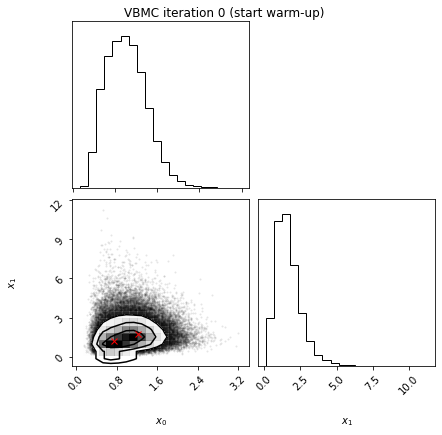

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     1         15          -2.68         0.76         0.51        2        inf     


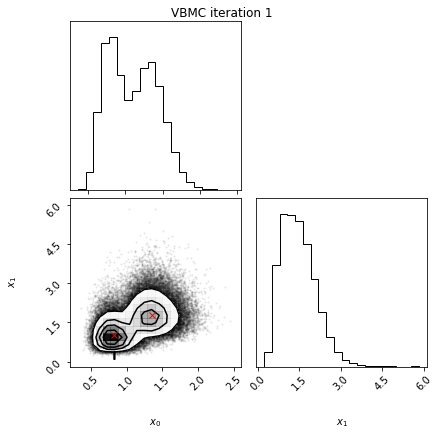

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     2         20          -2.61         0.60         0.08        2       4.17     


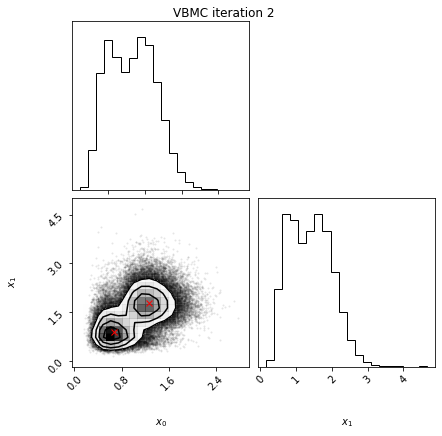

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     3         25          -2.48         0.27         0.16        2       5.03     


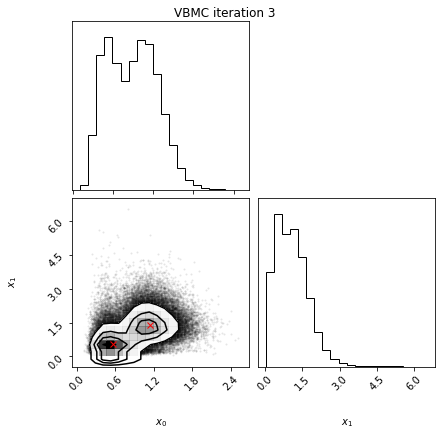

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     4         30          -2.43         0.06         0.03        2      0.987     


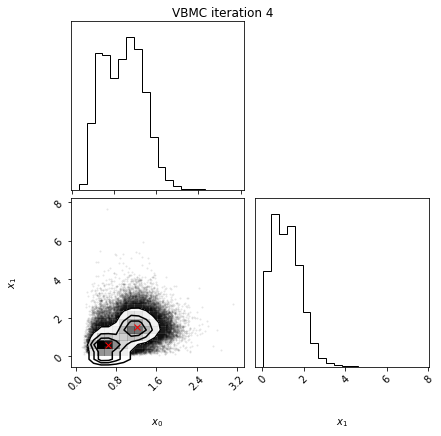

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     5         35          -2.41         0.01         0.01        2      0.374     


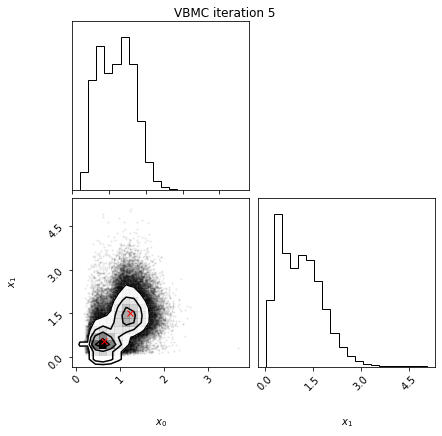

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     6         40          -2.36         0.01         0.02        2      0.655     end warm-up


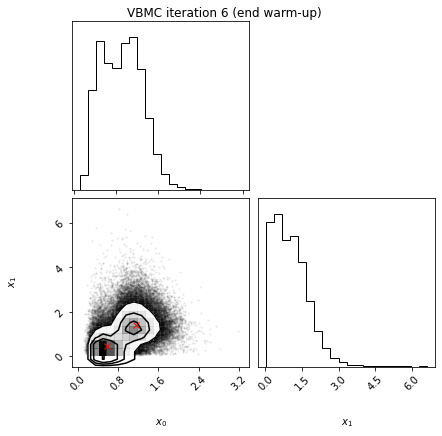

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     7         45          -2.33         0.01         0.01        2      0.446     


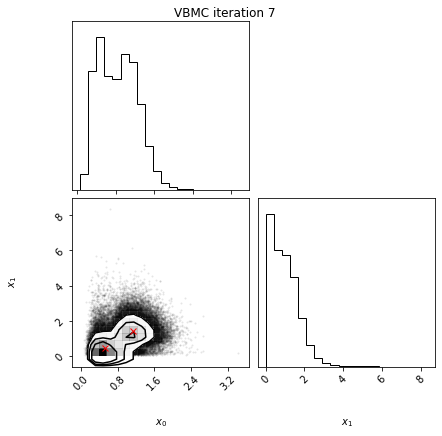

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     8         50          -2.33         0.01         0.00        2     0.0826     


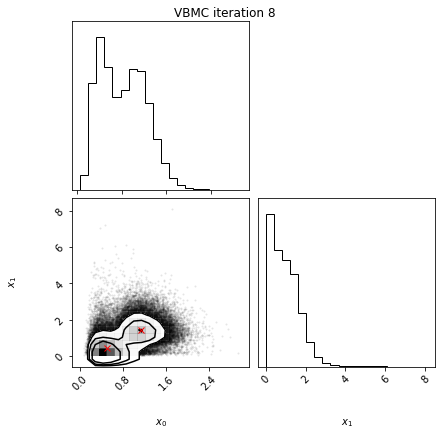

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
     9         55          -2.20         0.00         0.03        5       1.19     


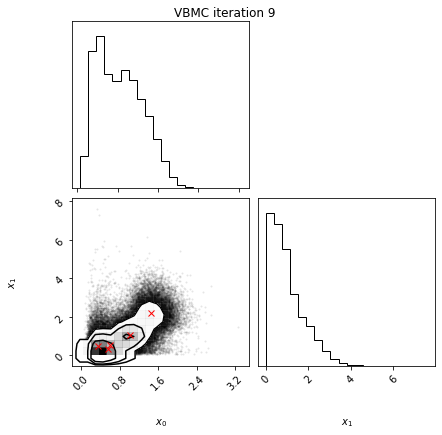

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    10         55          -2.00         0.08         0.13        6       3.99     rotoscale


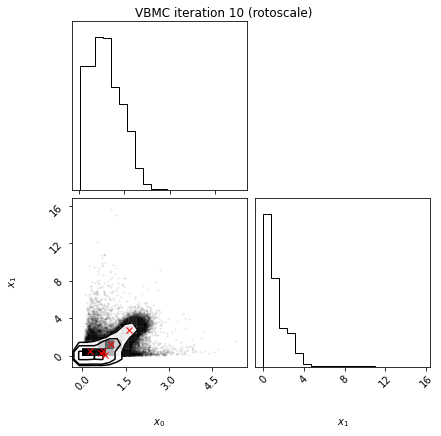

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    11         60          -1.35         0.49         0.11        6       6.49     


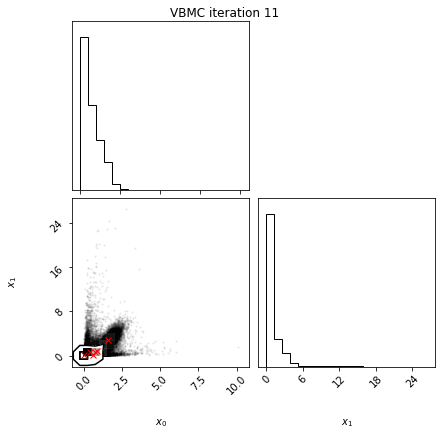

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    12         65          -2.05         0.10         0.08        6       4.44     


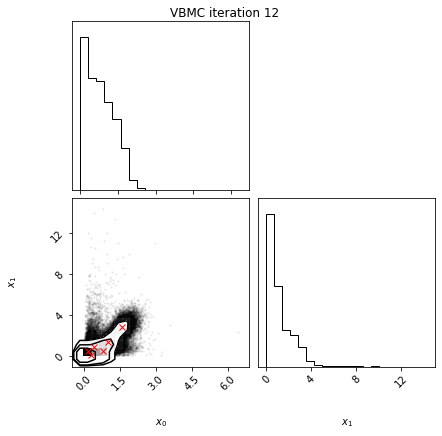

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    13         70          -2.04         0.05         0.03        6      0.973     


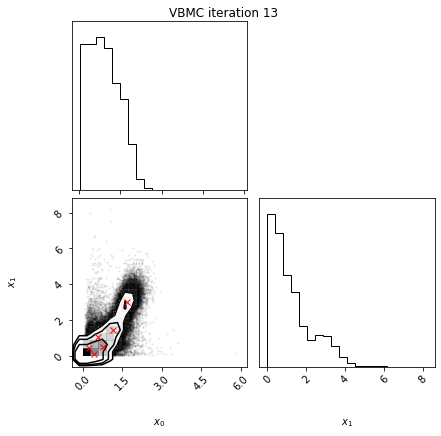

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    14         75          -1.95         0.06         0.11        9       3.08     


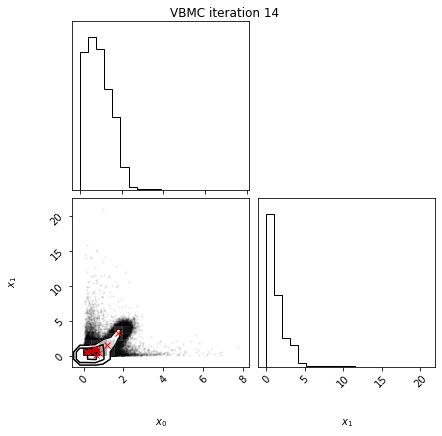

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    15         80          -1.98         0.05         0.02       10      0.618     


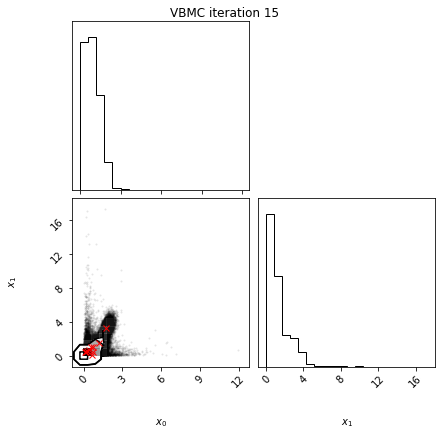

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    16         85          -1.97         0.05         0.00       10      0.298     rotoscale, undo rotoscale


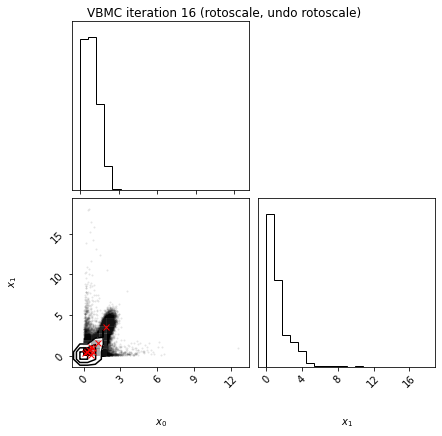

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    17         90          -1.94         0.03         0.01       13      0.507     


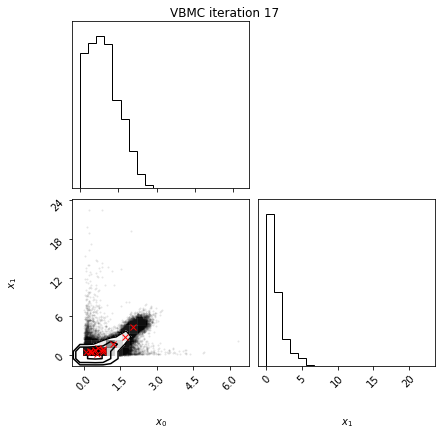

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    18         95          -1.93         0.03         0.02       16      0.571     


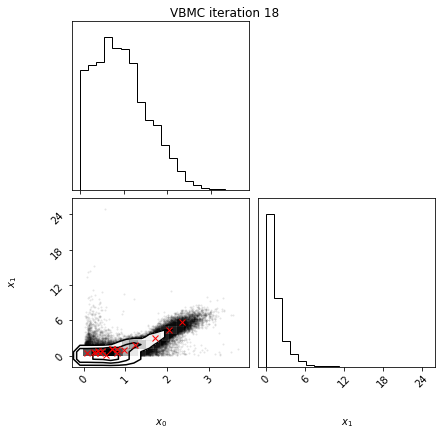

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    19        100          -1.92         0.02         0.02       19      0.481     


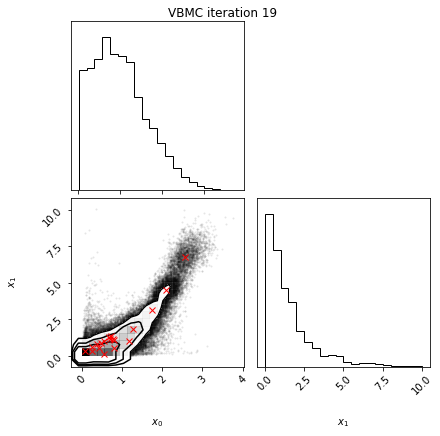

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    20        105          -1.91         0.01         0.02       20      0.502     


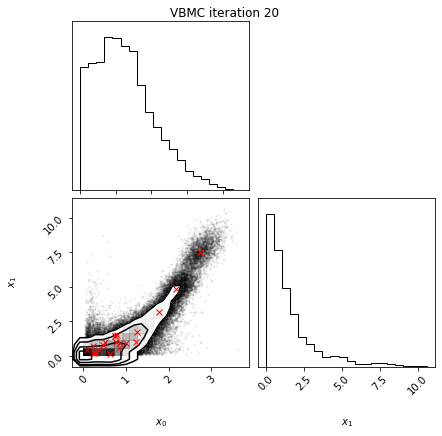

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    21        110          -1.91         0.01         0.00       19     0.0962     


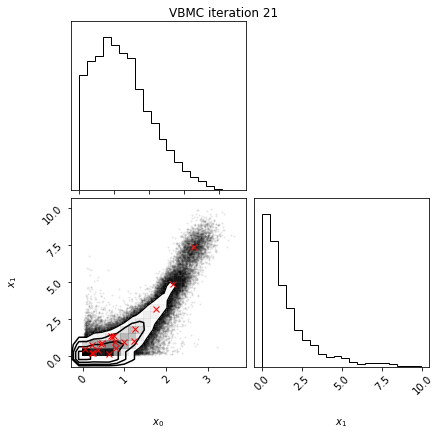

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    22        115          -1.91         0.01         0.00       19      0.116     


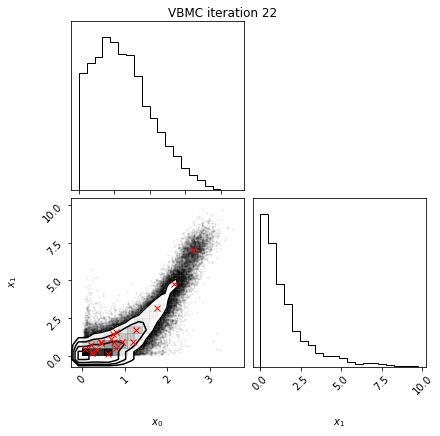

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
    23        120          -1.91         0.01         0.00       20     0.0584     stable


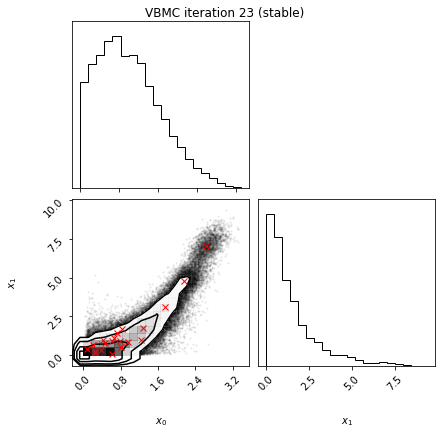

 Iteration  f-count    Mean[ELBO]    Std[ELBO]    sKL-iter[q]   K[q]  Convergence  Action
   inf        120          -1.88         0.01         0.00       50     0.0584     finalize


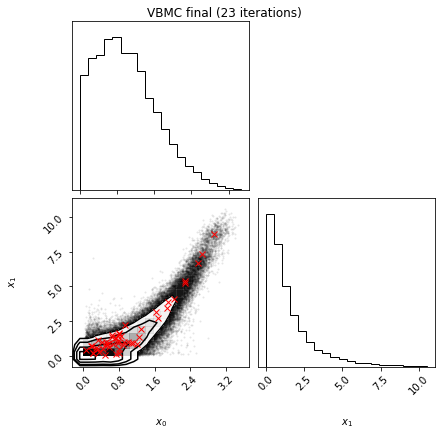

Inference terminated: variational solution stable for options.tol_stable_count fcn evaluations.
Estimated ELBO: -1.884 +/-0.009.


In [9]:
# run VBMC
vp, results = vbmc.optimize()

In [10]:
lml_true = -1.836  # ground truth, which we know for this toy scenario

print("The true log model evidence is:", lml_true)
print("The obtained ELBO is:", format(results["elbo"], ".3f"))
print("The obtained ELBO_SD is:", format(results["elbo_sd"], ".3f"))

The true log model evidence is: -1.836
The obtained ELBO is: -1.884
The obtained ELBO_SD is: 0.009


We can also print the `vp` object to see a summary of the variational solution:

In [11]:
print(vp)

VariationalPosterior:
    dimension = 2,
    num. components = 50,
    means: (2, 50) ndarray,
    weights: (1, 50) ndarray,
    sigma (per-component scale): (1, 50) ndarray,
    lambda (per-dimension scale): 
        [[0.9864],
         [1.0135]] : ndarray,
    stats = {
        'elbo': -1.8837797401410326,
        'elbo_sd': 0.009052797987329627,
        'e_log_joint': -2.834128044041677,
        'e_log_joint_sd': 0.009052797987329627,
        'entropy': 0.9503483039006446,
        'entropy_sd': 0.0,
        'stable': True : ndarray,
        'I_sk': (7, 50) ndarray,
        'J_sjk': (7, 50, 50) ndarray,
    }


## 4. Examine and visualize results

We will examine now the obtained variational posterior with an interactive plot.

*Note*: The interactive plot will not be visible in a notebook preview on GitHub. See below for a static image.

In [12]:
# Generate samples from the variational posterior
n_samples = int(3e5)
Xs, _ = vp.sample(n_samples)

# We compute the pdf of the approximate posterior on a 2-D grid
plot_lb = np.zeros(2)
plot_ub = np.quantile(Xs, 0.999, axis=0)
x1 = np.linspace(plot_lb[0], plot_ub[0], 400)
x2 = np.linspace(plot_lb[1], plot_ub[1], 400)

xa, xb = np.meshgrid(x1, x2)  # Build the grid
xx = np.vstack(
    (xa.ravel(), xb.ravel())
).T  # Convert grids to a vertical array of 2-D points
yy = vp.pdf(xx)  # Compute PDF values on specified points

/Users/lichengk/.miniforge3/envs/py39_forge/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning:

invalid value encountered in subtract



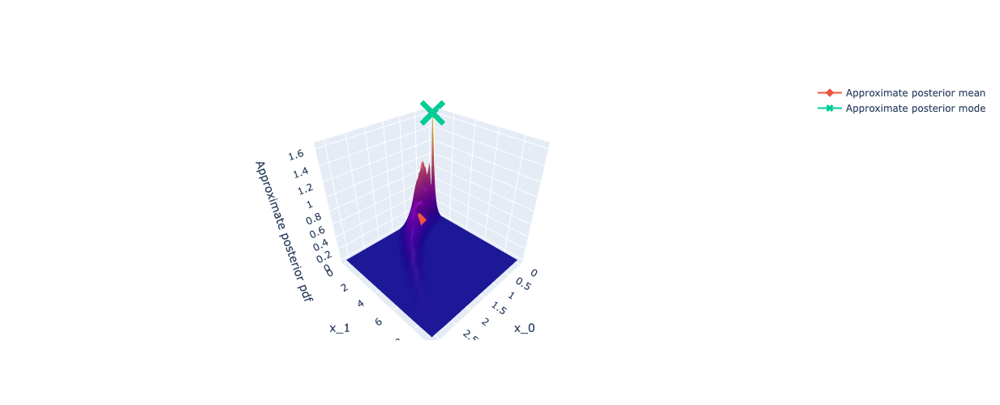

In [13]:
# You may need to run "jupyter labextension install jupyterlab-plotly" for plotly
# Plot approximate posterior pdf (this interactive plot does not work in higher D)
import plotly.graph_objects as go

fig = go.Figure(
    data=[
        go.Surface(z=yy.reshape(x1.size, x2.size), x=xa, y=xb, showscale=False)
    ]
)
fig.update_layout(
    autosize=False,
    width=800,
    height=500,
    scene=dict(
        xaxis_title="x_0",
        yaxis_title="x_1",
        zaxis_title="Approximate posterior pdf",
    ),
)

# Compute and plot approximate posterior mean
post_mean = np.mean(Xs, axis=0)
fig.add_trace(
    go.Scatter3d(
        x=[post_mean[0]],
        y=[post_mean[1]],
        z=vp.pdf(post_mean),
        name="Approximate posterior mean",
        marker_symbol="diamond",
    )
)

# Find and plot approximate posterior mode
post_mode = vp.mode(n_max=500)
fig.add_trace(go.Scatter3d(x=[post_mode[0]], y=[post_mode[1]], z=vp.pdf(post_mode), name="Approximate posterior mode", marker_symbol="x"))

In [14]:
# # Display posterior also as a non-interactive static image
# from IPython.display import Image

# Image(fig.to_image(format="png"))

## 5. Conclusions

In this notebook, we have discussed more in detail the input parameter settings (bounds and starting point) and the output trace of PyVBMC.

An important step still not considered in this example is a thorough validation of the results and diagnostics, which will be discussed in a later notebook.

## Acknowledgments

Work on the PyVBMC package was funded by the [Finnish Center for Artificial Intelligence FCAI](https://fcai.fi/).